# Demolitions analysis w/ Pandas

It might be worth doing this with only full demolitions data as it was downloaded from Socrata, instead of going through the download notebook.

To do:
- get pace for 2018 by comparing 1/2 years of last two years.
- get number of demos by zip by year. Where are they growing the most? Has a wave crested?
- altair is nice, but it is huge

In [1]:
import pandas as pd
import numpy as np
import altair as alt
import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
import cufflinks as cf

# cufflinks allows binding iplot to pandas dataframes and series
cf.set_config_file(offline=False, world_readable=True, theme='ggplot')


## Imports

- `demolitions.csv` is created by running the notebook `01_Download_process.ipynb`.

In [2]:
column_types = {
    "ApplicantPhone": pd.np.str,
    "ContractorPhone": pd.np.str,
    'CalendarYearIssued': pd.np.str,
}

# import raw data
data_raw = pd.read_csv(
    '../data-processed/demolitions.csv',
    index_col=None,
    dtype=column_types
)

In [3]:
# set df after import and and changes
demolitions = data_raw

## Residential vs Commercial

In [4]:
# show residential vs commercial
demolitions.PermitClassMapped.value_counts()

Residential    10485
Commercial       812
Name: PermitClassMapped, dtype: int64

In [5]:
# filter to just residential and just commercial
# so I can deal with them seperately
residential = demolitions[demolitions['PermitClassMapped'] == 'Residential']
commercial = demolitions[demolitions['PermitClassMapped'] == 'Commercial']

## Demo Type
Partial vs Full demo
- I did test that residential permits marked as "Partial" do not have PermitClass for full demo.

In [6]:
# count partial vs full
residential['DemoType'].value_counts()

Partial    5716
Full       4769
Name: DemoType, dtype: int64

In [7]:
# check PermitClass in partial demos
# looking for 645 or 646, which are full demos
# And looking for others to create a new partial demo df
partial = residential[residential['DemoType'] == "Partial"]
partial['PermitClass'].value_counts().sort_index()

R- 101 Single Family Houses                 15
R- 102 Secondary Apartment                   9
R- 103 Two Family Bldgs                      2
R- 329 Res Structures Other Than Bldg       20
R- 330  Accessory Use to Primary            17
R- 434 Addition & Alterations             5052
R- 435 Renovations/Remodel                 588
R- 436 Addn to increase housing units        1
R- 437 Residential Boat Dock                 1
R- 438 Residential Garage/Carport Addn      11
Name: PermitClass, dtype: int64

In [8]:
# Weeding out clearly non-residential
partial_home_demos = partial[
    (partial["PermitClass"] == "R- 101 Single Family Houses")
    | (partial["PermitClass"] == "R- 102 Secondary Apartment")
    | (partial["PermitClass"] == "R- 103 Two Family Bldgs")
    | (partial["PermitClass"] == "R- 434 Addition & Alterations")
    | (partial["PermitClass"] == "R- 436 Addn to increase housing units")
]


## Full demolitions of residential homes

In [9]:
# check full DemoType Full for different
# PermitClass values
full = residential[residential['DemoType'] == "Full"]
full['PermitClass'].value_counts()

R- 645 Demolition One Family Homes       3046
R- 649 Demolition All Other Bldgs Res    1602
R- 646 Demolition Two Family Bldgs        121
Name: PermitClass, dtype: int64

In [10]:
# this gets full_demo_homes, which are permits specifically
# to demolish single family or dual family homes
full_home_demos = residential[
    (residential['PermitClass'] == "R- 645 Demolition One Family Homes")
    | (residential['PermitClass'] == "R- 646 Demolition Two Family Bldgs")
]

##  Full home demos over time

In [11]:
# create series from row counts by year
full_demos_by_year = full_home_demos.CalendarYearIssued.value_counts()

# this chart uses the cufflinks library to bind iplot to dataframe/series
full_demos_by_year.iplot(
    kind='bar',
    yTitle='Number of permits',
    title='Demolitions per year',
    filename='demolitions_demos-by-year'
)


In [12]:
# same chart as above
# but I built a dataframe from the series first
# this is more steps, but perhaps clearer what is going on
yr_df = full_home_demos.CalendarYearIssued.value_counts().reset_index()
yr_df.columns = ['Year', 'Count']
yr_df.iplot(
    kind='bar',
    x='Year',
    y='Count',
    yTitle='Number of permits',
    title='Demolitions per year',
    filename='demolitions_demos-by-year-df'
)

## Square feet torn down over time

In [13]:
sqft = full_home_demos.groupby('CalendarYearIssued').sum().TotalExistingBldgSQFT

In [14]:
sqft.iplot(
    kind='bar',
    yTitle='Total square feet',
    title='Square footage demolished each year',
    filename='demolitions_full-year-sqft'
)

## Pace for 2018

To check if the pace for 2018 is ahead or behind other years, we'll need to filter the full data set down just to permits issued at the first of the year. We will want to re-run this after June concludes on the calendar.

In [15]:
# List to filter for first six months from text string
six_months_list = ['01', '02', '03', '04', '05', '06']

# Make df of first half year permits
# Based on splitting string of date and making sure
# that string is in the list above.
# (another way might be to convert to a date and us `.month`)
six_months_full_demos = full_home_demos[full_home_demos.IssuedDate.str[5:7].isin(six_months_list)]
six_months_full_demos.shape

(1657, 67)

In [16]:
six_month_counts = six_months_full_demos.CalendarYearIssued.value_counts()
six_month_counts.iplot(
    kind='bar',
    yTitle='Full demo permits',
    title='Full demolitions in first half of year',
    filename='demolitions_six-month-count'

)

### More on partial demos

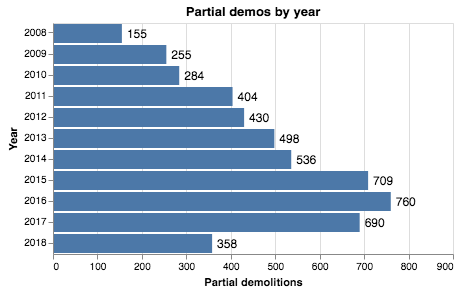

In [17]:
alt.data_transformers.enable('default', max_rows=None)

bars = alt.Chart(partial_home_demos, title="Partial demos by year").mark_bar().encode(
    x=alt.X(
        "count()",
        axis=alt.Axis(title="Partial demolitions"),
        scale=alt.Scale(domain=[0, 850])
    ),
    y=alt.Y("CalendarYearIssued", axis=alt.Axis(title="Year"))
)

text = bars.mark_text(
    align='center',
    baseline='middle',
    dx=15,
    size=12,
).encode(text='count()')


bars + text

## References

Keeping for column references and such. Ignore.

In [18]:
demolitions.info()
demolitions.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11297 entries, 0 to 11296
Data columns (total 67 columns):
PermitType                    11297 non-null object
PermitTypeDesc                11297 non-null object
PermitNum                     11297 non-null object
PermitClassMapped             11297 non-null object
PermitClass                   11297 non-null object
WorkClass                     11297 non-null object
Condominium                   11297 non-null object
ProjectName                   11297 non-null object
Description                   11297 non-null object
TCAD_ID                       11259 non-null object
PropertyLegalDescription      10609 non-null object
AppliedDate                   11297 non-null object
IssuedDate                    11297 non-null object
DayIssued                     11297 non-null object
CalendarYearIssued            11297 non-null object
FiscalYearIssued              11297 non-null int64
IssuedInLast30Days            11297 non-null object
Issuance

,PermitType,PermitTypeDesc,PermitNum,PermitClassMapped,PermitClass,WorkClass,Condominium,ProjectName,Description,TCAD_ID,...,ContractorCity,ContractorZip,ApplicantFullName,ApplicantOrganization,ApplicantPhone,ApplicantAddress1,ApplicantAddress2,ApplicantCity,ApplicantZip,DemoType
0,BP,Building Permit,2018-108511 BP,Residential,R- 645 Demolition One Family Homes,Demolition,No,4502 AVENUE F,total demo of sf res circa 1920,0222070828,...,ROUND ROCK,78665,LARRY HOLMAN,D&R Remodeling,5123508361,NaN,2910 Settlement DRIVE,ROUND ROCK,78665,Full
1,BP,Building Permit,2017-096972 BP,Residential,R- 645 Demolition One Family Homes,Demolition,No,600 W O DELL ST,total demo of house circa 1950,0233100807,...,Austin,78756,Elizabeth Wimberley,Waterlily Homes LLC,5126996577,NaN,4700 Hilwin CIRCLE,Austin,78756,Full
2,BP,Building Permit,2018-104615 BP,Residential,R- 645 Demolition One Family Homes,Demolition,No,2211 S 2ND ST,Total Demo Circa 1935,0402031003,...,AUSTIN,78741,Chris Affinito,Urban ATX Development LLC,9732203055,NaN,1705 DEERFIELD DRIVE,AUSTIN,78741,Full
3,BP,Building Permit,2018-104782 BP,Residential,R- 645 Demolition One Family Homes,Demolition,No,5805 CHESTERFIELD AVE,total demo of sf res c1951,0227090201,...,AUSTIN,78721,NaN,Urban Sawyers,5125634749,NaN,4602 TANNEY STREET,AUSTIN,78721,Full
4,BP,Building Permit,2018-093126 BP,Residential,R- 645 Demolition One Family Homes,Demolition,No,200 PARK LN,total demo of home 1958,0300010801,...,AUSTIN,78704,NaN,"Moore-Tate Projects and Design, LLC",5125179333,NaN,307-b W MONROE,AUSTIN,78704,Full
